In [1]:
%pylab inline

Populating the interactive namespace from numpy and matplotlib


In [2]:
import scape
import katdal
import katpoint
import katsdpscripts
import glob
import re
import pandas as pd 

import csv
import operator

INFO: Generating grammar tables from /usr/lib/python2.7/lib2to3/Grammar.txt
INFO: Generating grammar tables from /usr/lib/python2.7/lib2to3/PatternGrammar.txt


In [3]:
from os import system

In [4]:
print "Scape version: %s"%scape.__version__
print "katdal version: %s"%katdal.__version__
print "katpoint version: %s"%katpoint.__version__
print "katsdpscripts version: %s"%katsdpscripts.__version__

Scape version: 0.1.dev616+master.e836eb2
katdal version: 0.9.6.dev686+master.513f3ca
katpoint version: 0.8.dev355+master.341001f
katsdpscripts version: 0.1.dev2823+master.4932837


In [5]:
h5_filename ='/var/kat/archive3/data/MeerKATAR1/telescope_products/2018/04/30/1525046573.h5'\
# ' /var/kat/archive3/data/MeerKATAR1/telescope_products/2018/04/30/1525057673.h5'
%set_env h5_filename = $h5_filename
#last="/var/kat/archive3/data/MeerKATAR1/telescope_products/2018/04/30/1525057673.h5"

env: h5_filename=/var/kat/archive3/data/MeerKATAR1/telescope_products/2018/04/30/1525046573.h5


In [6]:
d = katdal.open(h5_filename)
#d=katdal.open(last)
ant_list,ants = [],[]
[ant_list.append(ant.name) for ant in d.ants]
print(ant_list)
print len(ant_list)

DEBUG: Found int_time=3.998308486 in telstate['sdp_l0_int_time']
DEBUG: Found scale_factor_timestamp=1712000000.0 in telstate[u'i0_scale_factor_timestamp']
DEBUG: Found sync_time=1525035378.0 in telstate[u'i0_sync_time']
DEBUG: Found n_chans=4096 in telstate['sdp_l0_n_chans']
DEBUG: Found bandwidth=856000000.0 in telstate['sdp_l0_bandwidth']
DEBUG: Found center_freq=1284000000.0 in telstate['sdp_l0_center_freq']
DEBUG: Added '1127-145' [radec] (and 1 aliases)
DEBUG: Added '1148-001' [radec] (and 1 aliases)
DEBUG: Added '1334-127' [radec] (and 1 aliases)
DEBUG: Added '1345+125' [radec] (and 1 aliases)
DEBUG: Added 'CTD93' [radec] (and 1 aliases)
DEBUG: Added '1709-281' [radec] (and 1 aliases)
DEBUG: Added '1722-554' [radec] (and 1 aliases)
DEBUG: Added 'NRAO530' [radec] (and 1 aliases)
DEBUG: Added '1740-517' [radec] (and 1 aliases)
DEBUG: Added '1827-360' [radec] (and 1 aliases)
DEBUG: Added '1830-210' [radec] (and 1 aliases)
DEBUG: Added 'OV-236' [radec] (and 1 aliases)
DEBUG: Added '

In [7]:
#ant_list.remove('m020') # not tracking most of the time
ants=','.join(ant_list)
print ants
%set_env ants=$ants

m000,m003,m004,m005,m006,m007,m008,m009,m011,m012,m013,m014,m015,m016,m017,m018,m019,m020,m021,m023,m024,m027,m028,m029,m030,m032,m033,m034,m037,m039,m040,m042,m043,m044,m045,m046,m047,m048,m049,m050,m051,m052,m054,m055,m056,m057,m058,m059,m061,m062,m063
env: ants=m000,m003,m004,m005,m006,m007,m008,m009,m011,m012,m013,m014,m015,m016,m017,m018,m019,m020,m021,m023,m024,m027,m028,m029,m030,m032,m033,m034,m037,m039,m040,m042,m043,m044,m045,m046,m047,m048,m049,m050,m051,m052,m054,m055,m056,m057,m058,m059,m061,m062,m063


In [8]:
ref_ant='m005'
%set_env ref_ant=$ref_ant

env: ref_ant=m005


In [9]:
matplotlib.rcParams['font.size']=6.0


Loading and processing data...

DEBUG: Found int_time=3.998308486 in telstate['sdp_l0_int_time']
DEBUG: Found scale_factor_timestamp=1712000000.0 in telstate[u'i0_scale_factor_timestamp']
DEBUG: Found sync_time=1525035378.0 in telstate[u'i0_sync_time']
DEBUG: Found n_chans=4096 in telstate['sdp_l0_n_chans']
DEBUG: Found bandwidth=856000000.0 in telstate['sdp_l0_bandwidth']
DEBUG: Found center_freq=1284000000.0 in telstate['sdp_l0_center_freq']
antennas (51): m000, m003, m004, m005 (*ref*), m006, m007, m008, m009, m011, m012, m013, m014, m015, m016, m017, m018, m019, m020, m021, m023, m024, m027, m028, m029, m030, m032, m033, m034, m037, m039, m040, m042, m043, m044, m045, m046, m047, m048, m049, m050, m051, m052, m054, m055, m056, m057, m058, m059, m061, m062, m063 [pol H]
baselines (1275): 0-1 0-2 1-2 0-3 1-3 2-3 0-4 1-4 2-4 3-4 0-5 1-5 2-5 3-5 4-5 0-6 1-6 2-6 3-6 4-6 5-6 0-7 1-7 2-7 3-7 4-7 5-7 6-7 0-8 1-8 2-8 3-8 4-8 5-8 6-8 7-8 0-9 1-9 2-9 3-9 4-9 5-9 6-9 7-9 8-9 0-10 1-10 2-10 3-

scan   3 (  31 samples) 0.088 0.093 0.102 0.093 0.093 0.097 0.091 0.086 0.099 0.087 0.091 0.088 0.099 0.088 0.086 0.095 0.095 0.094 0.094 0.094 0.097 0.092 0.097 0.093 0.100 0.098 0.105 0.096 0.088 0.081 0.099 0.093 0.088 0.087 0.094 0.094 0.092 0.086 0.103 0.094 0.085 0.085 0.102 0.108 0.087 0.090 0.084 0.096 0.084 0.081 0.082 0.091 0.102 0.085 0.083 0.093 0.089 0.093 0.088 0.084 0.089 0.091 0.098 0.093 0.087 0.083 0.083 0.085 0.092 0.087 0.082 0.086 0.090 0.090 0.083 0.086 0.083 0.088 0.087 0.093 0.093 0.096 0.090 0.090 0.095 0.097 0.094 0.099 0.092 0.093 0.088 0.092 0.092 0.093 0.088 0.088 0.090 0.092 0.094 0.091 0.094 0.084 0.083 0.090 0.093 0.092 0.086 0.098 0.086 0.089 0.091 0.094 0.099 0.089 0.087 0.083 0.082 0.085 0.098 0.086 0.085 0.092 0.092 0.093 0.088 0.091 0.093 0.093 0.086 0.092 0.088 0.100 0.083 0.102 0.091 0.103 0.087 0.088 0.090 0.099 0.099 0.090 0.092 0.093 0.089 0.093 0.089 0.086 0.090 0.089 0.089 0.091 0.096 0.091 0.089 0.089 0.086 0.089 0.090 0.087 0.096 0.090 0.08

scan   7 (  31 samples) 0.043 0.044 0.043 0.043 0.044 0.045 0.044 0.040 0.045 0.043 0.042 0.041 0.044 0.044 0.043 0.043 0.043 0.044 0.044 0.044 0.044 0.045 0.044 0.045 0.048 0.045 0.045 0.048 0.043 0.041 0.043 0.044 0.040 0.041 0.044 0.042 0.043 0.044 0.043 0.043 0.044 0.043 0.044 0.047 0.044 0.041 0.040 0.041 0.042 0.041 0.040 0.041 0.042 0.039 0.040 0.042 0.041 0.042 0.042 0.041 0.041 0.043 0.044 0.040 0.041 0.039 0.042 0.039 0.042 0.042 0.039 0.039 0.042 0.042 0.040 0.042 0.039 0.040 0.045 0.042 0.043 0.044 0.043 0.042 0.044 0.045 0.042 0.042 0.040 0.042 0.041 0.042 0.042 0.042 0.044 0.043 0.041 0.043 0.043 0.041 0.042 0.040 0.041 0.040 0.041 0.044 0.041 0.044 0.044 0.042 0.041 0.045 0.045 0.040 0.043 0.040 0.040 0.039 0.043 0.042 0.044 0.041 0.045 0.044 0.041 0.041 0.045 0.043 0.042 0.044 0.042 0.041 0.039 0.043 0.042 0.041 0.041 0.040 0.044 0.043 0.040 0.041 0.044 0.044 0.041 0.045 0.041 0.041 0.039 0.043 0.041 0.040 0.042 0.041 0.042 0.043 0.043 0.041 0.041 0.043 0.042 0.040 0.04

scan  13 (  31 samples) 0.045 0.047 0.051 0.048 0.046 0.054 0.044 0.046 0.048 0.046 0.046 0.048 0.046 0.050 0.047 0.047 0.048 0.050 0.049 0.047 0.049 0.050 0.049 0.048 0.049 0.049 0.051 0.051 0.046 0.048 0.045 0.050 0.047 0.044 0.047 0.049 0.046 0.048 0.047 0.051 0.046 0.047 0.046 0.048 0.045 0.045 0.047 0.046 0.047 0.045 0.043 0.046 0.049 0.041 0.046 0.044 0.044 0.049 0.046 0.044 0.046 0.047 0.049 0.045 0.048 0.044 0.043 0.043 0.049 0.046 0.043 0.045 0.046 0.047 0.045 0.047 0.042 0.042 0.048 0.050 0.048 0.048 0.046 0.047 0.050 0.051 0.047 0.048 0.044 0.048 0.046 0.048 0.048 0.047 0.047 0.045 0.048 0.047 0.047 0.045 0.045 0.043 0.047 0.046 0.045 0.046 0.045 0.050 0.044 0.044 0.049 0.047 0.046 0.047 0.048 0.045 0.044 0.045 0.048 0.046 0.047 0.049 0.046 0.051 0.048 0.045 0.047 0.049 0.043 0.046 0.044 0.046 0.044 0.049 0.045 0.049 0.048 0.045 0.046 0.047 0.048 0.048 0.046 0.046 0.046 0.046 0.046 0.045 0.045 0.050 0.045 0.047 0.045 0.046 0.043 0.049 0.046 0.046 0.048 0.049 0.046 0.047 0.04

scan  17 (  18 samples) 0.034 0.036 0.035 0.036 0.035 0.037 0.035 0.034 0.036 0.035 0.034 0.035 0.036 0.034 0.035 0.036 0.036 0.036 0.037 0.035 0.036 0.035 0.035 0.037 0.037 0.036 0.036 0.037 0.033 0.034 0.035 0.035 0.033 0.034 0.035 0.035 0.034 0.035 0.036 0.036 0.034 0.035 0.036 0.035 0.035 0.033 0.033 0.035 0.033 0.033 0.034 0.034 0.034 0.032 0.033 0.033 0.034 0.035 0.034 0.034 0.033 0.035 0.035 0.032 0.033 0.032 0.034 0.034 0.035 0.034 0.032 0.033 0.034 0.034 0.032 0.034 0.032 0.031 0.036 0.035 0.035 0.036 0.036 0.034 0.037 0.037 0.034 0.036 0.034 0.034 0.034 0.033 0.034 0.035 0.036 0.034 0.034 0.035 0.036 0.034 0.035 0.033 0.034 0.033 0.035 0.036 0.035 0.035 0.035 0.034 0.035 0.036 0.036 0.034 0.036 0.034 0.033 0.032 0.034 0.035 0.035 0.035 0.035 0.035 0.035 0.034 0.036 0.037 0.034 0.035 0.034 0.033 0.034 0.034 0.035 0.034 0.033 0.034 0.034 0.035 0.035 0.035 0.035 0.035 0.035 0.034 0.033 0.034 0.033 0.035 0.034 0.034 0.034 0.032 0.033 0.036 0.035 0.033 0.034 0.036 0.035 0.033 0.03

scan  21 (  32 samples) 0.027 0.027 0.026 0.026 0.029 0.028 0.026 0.027 0.028 0.025 0.025 0.028 0.028 0.028 0.026 0.027 0.028 0.027 0.028 0.027 0.026 0.026 0.028 0.029 0.027 0.027 0.025 0.027 0.027 0.026 0.028 0.026 0.025 0.026 0.027 0.027 0.027 0.027 0.027 0.027 0.028 0.027 0.027 0.027 0.028 0.026 0.026 0.027 0.026 0.025 0.027 0.028 0.026 0.026 0.026 0.026 0.026 0.027 0.026 0.024 0.025 0.026 0.026 0.024 0.028 0.025 0.026 0.026 0.027 0.026 0.025 0.027 0.026 0.027 0.025 0.028 0.024 0.025 0.027 0.027 0.026 0.027 0.027 0.028 0.028 0.029 0.027 0.028 0.026 0.027 0.024 0.025 0.027 0.028 0.025 0.025 0.026 0.027 0.027 0.026 0.026 0.025 0.025 0.026 0.027 0.028 0.027 0.026 0.028 0.027 0.028 0.028 0.028 0.026 0.027 0.025 0.026 0.024 0.026 0.028 0.027 0.026 0.028 0.026 0.025 0.027 0.027 0.028 0.025 0.028 0.027 0.025 0.025 0.028 0.027 0.027 0.026 0.027 0.027 0.026 0.026 0.027 0.027 0.028 0.026 0.027 0.025 0.026 0.024 0.024 0.026 0.025 0.027 0.027 0.027 0.027 0.027 0.025 0.027 0.026 0.027 0.026 0.02

scan  25 (  32 samples) 0.015 0.015 0.016 0.015 0.015 0.016 0.015 0.015 0.016 0.015 0.015 0.015 0.015 0.016 0.015 0.015 0.015 0.016 0.016 0.015 0.016 0.016 0.016 0.017 0.016 0.016 0.016 0.016 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.016 0.015 0.015 0.016 0.016 0.015 0.016 0.016 0.016 0.015 0.014 0.015 0.015 0.015 0.014 0.015 0.015 0.016 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.016 0.015 0.015 0.014 0.014 0.014 0.015 0.015 0.014 0.015 0.015 0.015 0.014 0.015 0.014 0.014 0.016 0.016 0.016 0.016 0.015 0.016 0.016 0.016 0.015 0.016 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.016 0.014 0.015 0.014 0.014 0.014 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.016 0.015 0.015 0.014 0.015 0.015 0.015 0.015 0.015 0.015 0.016 0.015 0.015 0.015 0.016 0.016 0.015 0.015 0.014 0.015 0.014 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.014 0.015 0.015 0.016 0.015 0.015 0.014 0.014 0.014 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.014 0.015 0.015 0.016 0.014 0.01

scan  29 (  32 samples) 0.054 0.056 0.056 0.054 0.060 0.062 0.056 0.057 0.060 0.058 0.061 0.063 0.058 0.056 0.053 0.071 0.074 0.062 0.067 0.068 0.064 0.064 0.061 0.055 0.080 0.061 0.056 0.064 0.061 0.061 0.058 0.054 0.049 0.057 0.058 0.060 0.058 0.052 0.062 0.056 0.055 0.057 0.064 0.062 0.053 0.049 0.045 0.059 0.058 0.055 0.057 0.069 0.060 0.060 0.057 0.055 0.055 0.061 0.058 0.056 0.064 0.063 0.063 0.055 0.055 0.052 0.057 0.058 0.059 0.057 0.058 0.061 0.062 0.059 0.056 0.060 0.060 0.062 0.063 0.063 0.060 0.062 0.064 0.068 0.060 0.063 0.056 0.059 0.062 0.059 0.058 0.056 0.060 0.067 0.064 0.056 0.062 0.065 0.069 0.063 0.067 0.058 0.056 0.056 0.071 0.058 0.059 0.057 0.061 0.055 0.058 0.066 0.063 0.057 0.054 0.059 0.058 0.053 0.063 0.057 0.057 0.055 0.057 0.059 0.054 0.063 0.064 0.064 0.053 0.063 0.053 0.055 0.054 0.059 0.057 0.072 0.051 0.049 0.057 0.057 0.057 0.056 0.064 0.057 0.056 0.058 0.044 0.056 0.056 0.063 0.066 0.057 0.050 0.062 0.061 0.058 0.055 0.060 0.060 0.056 0.059 0.058 0.05

scan  35 (  31 samples) 0.045 0.051 0.048 0.045 0.047 0.055 0.042 0.045 0.050 0.045 0.048 0.048 0.049 0.051 0.048 0.049 0.048 0.051 0.049 0.050 0.048 0.048 0.050 0.050 0.053 0.049 0.046 0.051 0.043 0.044 0.050 0.045 0.043 0.047 0.049 0.050 0.045 0.047 0.047 0.048 0.046 0.049 0.049 0.052 0.044 0.046 0.048 0.046 0.048 0.047 0.044 0.045 0.046 0.047 0.045 0.044 0.044 0.048 0.044 0.043 0.048 0.047 0.050 0.043 0.046 0.046 0.047 0.046 0.046 0.047 0.046 0.045 0.046 0.044 0.047 0.048 0.042 0.048 0.048 0.049 0.049 0.050 0.048 0.046 0.050 0.046 0.048 0.050 0.045 0.050 0.042 0.047 0.045 0.046 0.049 0.046 0.046 0.048 0.048 0.047 0.046 0.047 0.046 0.047 0.048 0.048 0.048 0.047 0.050 0.050 0.047 0.047 0.047 0.048 0.046 0.043 0.047 0.044 0.046 0.048 0.047 0.047 0.046 0.049 0.045 0.048 0.051 0.048 0.047 0.047 0.048 0.048 0.047 0.048 0.044 0.050 0.044 0.045 0.050 0.045 0.044 0.045 0.046 0.047 0.044 0.048 0.046 0.042 0.045 0.046 0.048 0.046 0.048 0.049 0.047 0.045 0.049 0.048 0.045 0.046 0.045 0.047 0.04

scan  39 (  32 samples) 0.033 0.035 0.035 0.034 0.035 0.037 0.034 0.034 0.034 0.035 0.034 0.034 0.035 0.034 0.034 0.035 0.036 0.036 0.036 0.036 0.036 0.035 0.036 0.036 0.037 0.035 0.036 0.037 0.033 0.033 0.034 0.034 0.034 0.033 0.035 0.033 0.034 0.035 0.036 0.036 0.035 0.035 0.035 0.037 0.036 0.033 0.033 0.035 0.034 0.032 0.034 0.035 0.034 0.033 0.034 0.033 0.033 0.034 0.034 0.032 0.033 0.035 0.034 0.032 0.035 0.033 0.033 0.033 0.033 0.033 0.032 0.033 0.034 0.035 0.034 0.033 0.031 0.031 0.036 0.035 0.035 0.035 0.033 0.035 0.036 0.035 0.035 0.037 0.034 0.033 0.033 0.033 0.033 0.034 0.034 0.033 0.033 0.035 0.035 0.033 0.035 0.033 0.033 0.033 0.034 0.033 0.033 0.034 0.034 0.033 0.034 0.035 0.034 0.032 0.036 0.033 0.032 0.033 0.034 0.033 0.033 0.034 0.036 0.034 0.034 0.033 0.035 0.036 0.034 0.035 0.034 0.034 0.033 0.035 0.034 0.034 0.034 0.033 0.034 0.035 0.033 0.035 0.035 0.035 0.034 0.034 0.032 0.033 0.032 0.033 0.033 0.034 0.035 0.034 0.035 0.034 0.033 0.032 0.033 0.034 0.035 0.034 0.03

scan  43 (  32 samples) 0.029 0.026 0.029 0.027 0.027 0.028 0.026 0.028 0.027 0.027 0.027 0.027 0.027 0.028 0.028 0.027 0.028 0.028 0.028 0.027 0.027 0.027 0.029 0.029 0.027 0.027 0.029 0.029 0.027 0.027 0.027 0.028 0.027 0.026 0.027 0.029 0.027 0.027 0.028 0.027 0.026 0.028 0.027 0.028 0.027 0.026 0.026 0.027 0.027 0.026 0.026 0.026 0.026 0.026 0.025 0.026 0.027 0.027 0.027 0.025 0.027 0.026 0.026 0.026 0.025 0.024 0.026 0.027 0.026 0.027 0.024 0.026 0.026 0.027 0.025 0.025 0.024 0.024 0.028 0.027 0.027 0.027 0.028 0.025 0.028 0.028 0.026 0.028 0.027 0.028 0.027 0.025 0.028 0.027 0.026 0.025 0.027 0.028 0.027 0.027 0.027 0.025 0.026 0.026 0.027 0.027 0.027 0.028 0.027 0.025 0.028 0.029 0.027 0.027 0.027 0.026 0.025 0.025 0.028 0.026 0.027 0.026 0.028 0.027 0.027 0.027 0.029 0.028 0.027 0.028 0.027 0.027 0.027 0.026 0.027 0.026 0.026 0.027 0.027 0.026 0.027 0.026 0.028 0.026 0.028 0.027 0.025 0.026 0.027 0.025 0.026 0.026 0.026 0.026 0.027 0.026 0.028 0.025 0.026 0.028 0.028 0.026 0.02

scan  47 (  32 samples) 0.015 0.015 0.016 0.015 0.015 0.016 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.016 0.015 0.015 0.016 0.016 0.016 0.015 0.016 0.016 0.016 0.016 0.016 0.016 0.016 0.016 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.016 0.016 0.015 0.015 0.016 0.016 0.015 0.014 0.014 0.015 0.015 0.015 0.015 0.015 0.015 0.014 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.014 0.015 0.014 0.014 0.014 0.015 0.015 0.014 0.014 0.015 0.015 0.014 0.015 0.014 0.014 0.015 0.015 0.016 0.016 0.015 0.015 0.015 0.016 0.015 0.016 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.016 0.015 0.015 0.015 0.014 0.014 0.015 0.015 0.015 0.016 0.015 0.015 0.015 0.015 0.016 0.015 0.015 0.014 0.015 0.014 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.016 0.016 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.014 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.015 0.014 0.014 0.014 0.015 0.014 0.015 0.015 0.014 0.015 0.015 0.015 0.014 0.015 0.015 0.015 0.014 0.01

scan  51 (  32 samples) 0.037 0.040 0.040 0.040 0.041 0.042 0.037 0.040 0.042 0.039 0.038 0.038 0.042 0.039 0.038 0.039 0.041 0.040 0.042 0.039 0.041 0.041 0.041 0.043 0.042 0.041 0.042 0.043 0.038 0.039 0.041 0.038 0.039 0.038 0.040 0.043 0.040 0.039 0.040 0.042 0.041 0.039 0.042 0.041 0.040 0.037 0.036 0.039 0.039 0.038 0.037 0.039 0.040 0.038 0.038 0.039 0.039 0.040 0.038 0.038 0.038 0.040 0.041 0.037 0.039 0.038 0.039 0.038 0.039 0.037 0.038 0.037 0.038 0.040 0.037 0.038 0.037 0.035 0.037 0.039 0.041 0.039 0.039 0.039 0.041 0.042 0.038 0.042 0.039 0.039 0.038 0.038 0.038 0.040 0.039 0.038 0.038 0.039 0.040 0.039 0.040 0.037 0.038 0.037 0.038 0.038 0.039 0.041 0.038 0.037 0.038 0.040 0.041 0.037 0.040 0.039 0.037 0.037 0.039 0.037 0.040 0.040 0.040 0.039 0.039 0.039 0.041 0.041 0.038 0.040 0.039 0.037 0.037 0.041 0.038 0.038 0.038 0.039 0.041 0.039 0.037 0.038 0.040 0.042 0.036 0.040 0.037 0.038 0.037 0.039 0.038 0.036 0.037 0.038 0.039 0.040 0.037 0.036 0.038 0.040 0.040 0.037 0.03

scan  55 (  27 samples) 0.046 0.048 0.046 0.046 0.048 0.049 0.047 0.044 0.045 0.046 0.045 0.045 0.046 0.045 0.045 0.047 0.048 0.051 0.046 0.048 0.049 0.048 0.050 0.052 0.049 0.051 0.049 0.049 0.046 0.045 0.048 0.048 0.045 0.048 0.047 0.047 0.048 0.046 0.047 0.046 0.045 0.045 0.048 0.050 0.048 0.044 0.045 0.048 0.044 0.045 0.045 0.044 0.045 0.041 0.046 0.044 0.046 0.047 0.045 0.044 0.046 0.046 0.048 0.042 0.044 0.042 0.045 0.043 0.044 0.045 0.043 0.042 0.046 0.047 0.043 0.044 0.042 0.044 0.046 0.047 0.048 0.046 0.046 0.049 0.048 0.053 0.046 0.048 0.045 0.045 0.048 0.046 0.046 0.045 0.046 0.045 0.045 0.047 0.050 0.046 0.044 0.046 0.044 0.042 0.045 0.044 0.045 0.047 0.046 0.045 0.046 0.047 0.051 0.044 0.046 0.044 0.043 0.043 0.047 0.045 0.044 0.045 0.047 0.045 0.044 0.045 0.048 0.049 0.044 0.046 0.043 0.045 0.044 0.049 0.046 0.044 0.043 0.044 0.047 0.045 0.045 0.044 0.046 0.047 0.045 0.046 0.042 0.043 0.044 0.047 0.046 0.045 0.042 0.044 0.044 0.045 0.045 0.044 0.043 0.046 0.048 0.044 0.04

scan  61 (  32 samples) 0.045 0.044 0.047 0.048 0.047 0.054 0.043 0.045 0.045 0.051 0.049 0.047 0.050 0.049 0.049 0.049 0.048 0.050 0.050 0.048 0.045 0.047 0.046 0.049 0.048 0.046 0.050 0.051 0.045 0.049 0.049 0.048 0.046 0.044 0.047 0.048 0.047 0.045 0.049 0.048 0.046 0.049 0.050 0.045 0.048 0.046 0.048 0.048 0.046 0.047 0.044 0.046 0.048 0.042 0.049 0.043 0.044 0.045 0.047 0.043 0.047 0.048 0.047 0.047 0.045 0.048 0.047 0.048 0.048 0.046 0.047 0.043 0.047 0.047 0.042 0.046 0.041 0.047 0.049 0.046 0.049 0.046 0.048 0.048 0.047 0.050 0.049 0.048 0.046 0.046 0.047 0.046 0.045 0.047 0.047 0.047 0.046 0.048 0.048 0.048 0.049 0.045 0.045 0.046 0.045 0.043 0.045 0.045 0.047 0.044 0.050 0.050 0.046 0.048 0.047 0.048 0.043 0.046 0.048 0.045 0.044 0.045 0.046 0.047 0.044 0.050 0.049 0.047 0.050 0.047 0.048 0.042 0.051 0.047 0.046 0.044 0.044 0.046 0.046 0.050 0.044 0.047 0.049 0.047 0.043 0.048 0.045 0.045 0.043 0.053 0.045 0.044 0.048 0.047 0.046 0.047 0.045 0.047 0.044 0.046 0.047 0.045 0.04


Fitting 200 parameters to 1144360 data points (discarded 590)...
Condition number = 82.083

Antenna m000 
------------
E (m):                -8.263 +- 0.01097 (was  -8.258)
N (m):               -207.291 +- 0.00868 (was -207.289)
U (m):                 1.214 +- 0.02277 (was   1.208)
Cable length (m):    5875.413 +- 0.01209 (was 5874.184) *
Receiver delay (ns): 27997.524 +- 0.058   (was 27991.670) *

Antenna m003 
------------
E (m):               -66.518 +- 0.01101 (was -66.516)
N (m):               -202.278 +- 0.00872 (was -202.276)
U (m):                 0.889 +- 0.02289 (was   0.888)
Cable length (m):    5872.902 +- 0.01215 (was 5871.551) *
Receiver delay (ns): 27985.560 +- 0.058   (was 27979.123) *

Antenna m004 
------------
E (m):               -123.617 +- 0.01118 (was -123.620)
N (m):               -252.945 +- 0.00886 (was -252.946)
U (m):                 1.114 +- 0.02326 (was   1.113)
Cable length (m):    5873.024 +- 0.01235 (was 5871.553) *
Receiver delay (ns): 27986.144 +- 0.

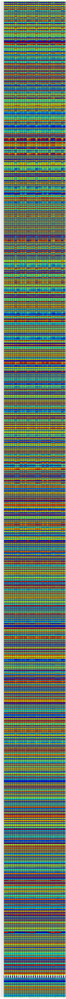

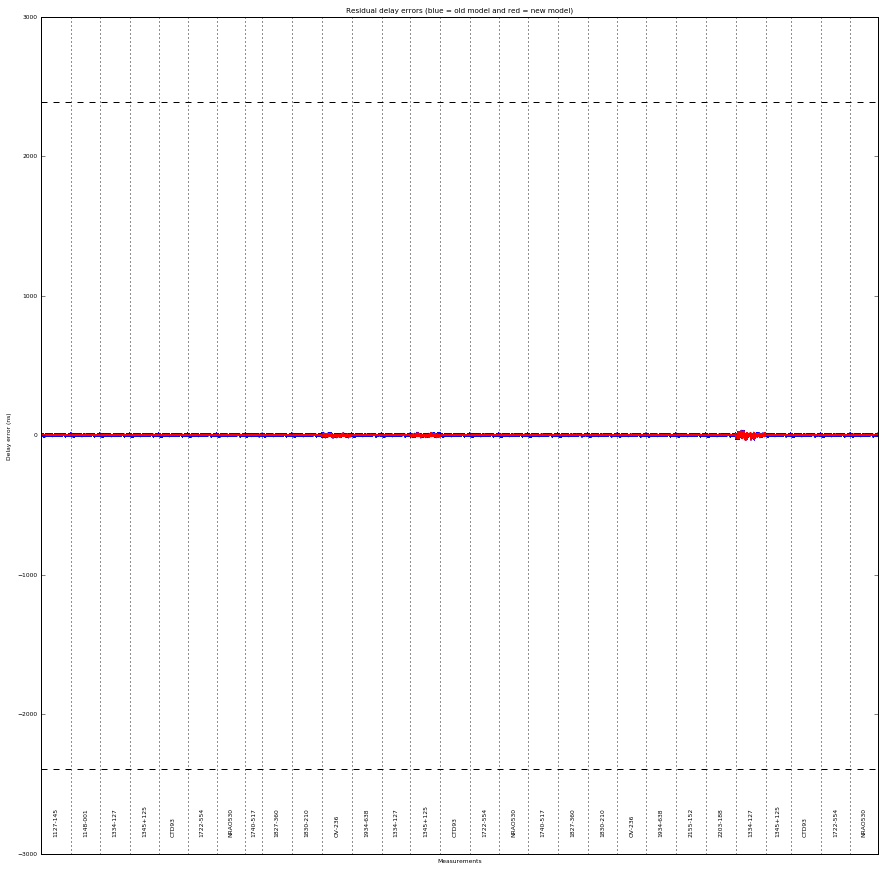

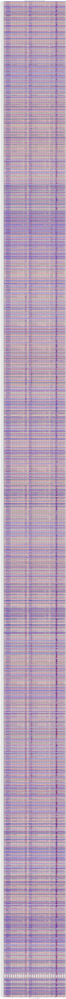

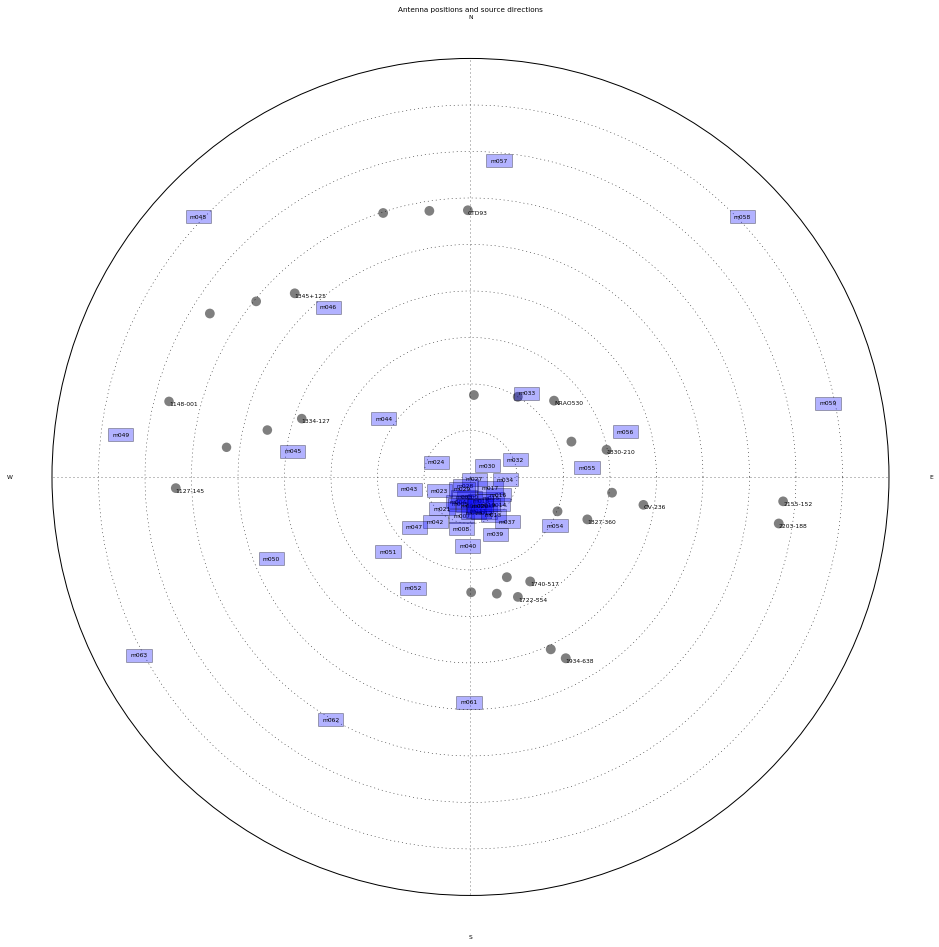

In [10]:
figure(1,figsize=(15,240))
figure(2,figsize=(15,15))
figure(3,figsize=(15,240))
figure(4,figsize=(15,15))
%run /var/kat/katsdpscripts/reduction/baseline_cal_reduction.py -f 2200,2914 -p 'H' -r $ref_ant \
 -a $ants -x '1709-281'  $h5_filename


Loading and processing data...

DEBUG: Found int_time=3.998308486 in telstate['sdp_l0_int_time']
DEBUG: Found scale_factor_timestamp=1712000000.0 in telstate[u'i0_scale_factor_timestamp']
DEBUG: Found sync_time=1525035378.0 in telstate[u'i0_sync_time']
DEBUG: Found n_chans=4096 in telstate['sdp_l0_n_chans']
DEBUG: Found bandwidth=856000000.0 in telstate['sdp_l0_bandwidth']
DEBUG: Found center_freq=1284000000.0 in telstate['sdp_l0_center_freq']
antennas (51): m000, m003, m004, m005 (*ref*), m006, m007, m008, m009, m011, m012, m013, m014, m015, m016, m017, m018, m019, m020, m021, m023, m024, m027, m028, m029, m030, m032, m033, m034, m037, m039, m040, m042, m043, m044, m045, m046, m047, m048, m049, m050, m051, m052, m054, m055, m056, m057, m058, m059, m061, m062, m063 [pol V]
baselines (1275): 0-1 0-2 1-2 0-3 1-3 2-3 0-4 1-4 2-4 3-4 0-5 1-5 2-5 3-5 4-5 0-6 1-6 2-6 3-6 4-6 5-6 0-7 1-7 2-7 3-7 4-7 5-7 6-7 0-8 1-8 2-8 3-8 4-8 5-8 6-8 7-8 0-9 1-9 2-9 3-9 4-9 5-9 6-9 7-9 8-9 0-10 1-10 2-10 3-

scan   3 (  31 samples) 0.088 0.095 0.101 0.095 0.094 0.099 0.093 0.086 0.100 0.091 0.089 0.086 0.096 0.088 0.085 0.094 0.093 0.094 0.095 0.093 0.094 0.092 0.094 0.093 0.100 0.098 0.100 0.094 0.089 0.081 0.098 0.094 0.090 0.085 0.093 0.091 0.091 0.084 0.102 0.094 0.086 0.083 0.098 0.104 0.087 0.094 0.087 0.101 0.090 0.085 0.083 0.094 0.104 0.089 0.087 0.099 0.093 0.098 0.094 0.091 0.092 0.095 0.101 0.097 0.092 0.091 0.087 0.087 0.095 0.092 0.085 0.086 0.091 0.093 0.086 0.086 0.089 0.097 0.085 0.089 0.090 0.095 0.088 0.087 0.091 0.091 0.088 0.091 0.093 0.094 0.089 0.093 0.093 0.094 0.091 0.089 0.090 0.093 0.094 0.093 0.094 0.089 0.089 0.092 0.093 0.092 0.085 0.098 0.087 0.090 0.088 0.091 0.098 0.091 0.085 0.088 0.086 0.088 0.094 0.087 0.087 0.092 0.093 0.097 0.091 0.090 0.094 0.093 0.089 0.093 0.094 0.107 0.087 0.088 0.095 0.102 0.092 0.093 0.094 0.104 0.104 0.093 0.095 0.096 0.095 0.096 0.098 0.096 0.098 0.090 0.095 0.096 0.102 0.091 0.091 0.091 0.087 0.091 0.088 0.086 0.096 0.091 0.09

scan   7 (  31 samples) 0.047 0.048 0.047 0.048 0.049 0.050 0.048 0.044 0.050 0.048 0.045 0.044 0.047 0.049 0.047 0.047 0.046 0.048 0.049 0.048 0.047 0.049 0.048 0.049 0.052 0.049 0.048 0.051 0.048 0.045 0.047 0.050 0.045 0.045 0.047 0.046 0.046 0.047 0.047 0.047 0.048 0.045 0.046 0.051 0.047 0.048 0.046 0.047 0.050 0.048 0.045 0.047 0.048 0.046 0.046 0.049 0.047 0.049 0.051 0.048 0.047 0.050 0.050 0.047 0.047 0.048 0.048 0.045 0.048 0.049 0.045 0.044 0.047 0.047 0.045 0.048 0.046 0.048 0.046 0.045 0.046 0.048 0.047 0.044 0.047 0.048 0.045 0.045 0.044 0.048 0.043 0.047 0.047 0.047 0.050 0.049 0.045 0.048 0.049 0.046 0.047 0.046 0.049 0.046 0.044 0.048 0.044 0.049 0.049 0.046 0.044 0.049 0.048 0.045 0.047 0.046 0.047 0.044 0.045 0.047 0.049 0.045 0.050 0.049 0.047 0.045 0.050 0.048 0.047 0.048 0.049 0.049 0.046 0.046 0.048 0.046 0.047 0.046 0.051 0.051 0.047 0.047 0.050 0.050 0.047 0.051 0.049 0.049 0.047 0.047 0.048 0.046 0.050 0.045 0.046 0.048 0.049 0.046 0.044 0.048 0.046 0.044 0.04

scan  13 (  31 samples) 0.049 0.050 0.055 0.053 0.051 0.064 0.049 0.048 0.053 0.051 0.048 0.050 0.048 0.054 0.049 0.050 0.051 0.053 0.053 0.050 0.051 0.054 0.051 0.051 0.053 0.052 0.054 0.053 0.049 0.050 0.048 0.054 0.051 0.046 0.050 0.052 0.048 0.050 0.049 0.055 0.049 0.049 0.049 0.051 0.049 0.051 0.052 0.051 0.055 0.051 0.048 0.052 0.055 0.047 0.050 0.050 0.049 0.055 0.053 0.050 0.050 0.054 0.055 0.051 0.054 0.053 0.048 0.048 0.053 0.051 0.048 0.048 0.050 0.052 0.050 0.050 0.049 0.048 0.048 0.051 0.050 0.051 0.049 0.048 0.051 0.052 0.049 0.048 0.047 0.053 0.049 0.052 0.052 0.051 0.052 0.050 0.051 0.051 0.051 0.048 0.049 0.050 0.054 0.051 0.049 0.049 0.047 0.053 0.049 0.048 0.052 0.051 0.049 0.051 0.049 0.052 0.050 0.048 0.049 0.050 0.052 0.054 0.050 0.057 0.052 0.048 0.051 0.053 0.046 0.048 0.049 0.053 0.049 0.051 0.050 0.054 0.055 0.049 0.052 0.055 0.054 0.052 0.051 0.051 0.053 0.052 0.055 0.054 0.053 0.054 0.051 0.053 0.052 0.050 0.046 0.053 0.049 0.052 0.051 0.053 0.050 0.052 0.05

scan  17 (  18 samples) 0.037 0.039 0.037 0.039 0.037 0.041 0.037 0.037 0.039 0.038 0.036 0.036 0.038 0.036 0.037 0.038 0.038 0.039 0.040 0.037 0.038 0.038 0.038 0.039 0.040 0.038 0.037 0.038 0.036 0.037 0.037 0.039 0.036 0.036 0.038 0.037 0.036 0.037 0.038 0.038 0.037 0.037 0.037 0.037 0.037 0.037 0.037 0.039 0.039 0.037 0.037 0.038 0.037 0.037 0.036 0.038 0.038 0.039 0.039 0.039 0.036 0.039 0.039 0.036 0.038 0.038 0.037 0.036 0.039 0.038 0.036 0.035 0.037 0.037 0.036 0.036 0.038 0.037 0.036 0.036 0.037 0.038 0.037 0.036 0.037 0.038 0.036 0.036 0.037 0.037 0.037 0.036 0.037 0.038 0.040 0.038 0.037 0.038 0.038 0.037 0.038 0.038 0.039 0.037 0.037 0.038 0.037 0.037 0.037 0.037 0.036 0.038 0.039 0.036 0.037 0.038 0.037 0.036 0.035 0.038 0.039 0.038 0.038 0.039 0.038 0.037 0.039 0.040 0.037 0.038 0.038 0.038 0.039 0.036 0.039 0.036 0.038 0.038 0.038 0.040 0.039 0.038 0.039 0.039 0.038 0.038 0.039 0.040 0.039 0.037 0.039 0.038 0.039 0.035 0.037 0.039 0.038 0.036 0.036 0.038 0.037 0.036 0.03

scan  21 (  32 samples) 0.028 0.029 0.027 0.029 0.031 0.031 0.028 0.029 0.031 0.028 0.026 0.028 0.029 0.029 0.028 0.029 0.029 0.029 0.029 0.028 0.027 0.028 0.030 0.030 0.030 0.028 0.026 0.028 0.028 0.027 0.030 0.028 0.027 0.027 0.028 0.028 0.028 0.028 0.029 0.029 0.029 0.027 0.028 0.028 0.030 0.028 0.029 0.030 0.030 0.028 0.028 0.030 0.029 0.029 0.028 0.029 0.029 0.030 0.030 0.028 0.028 0.029 0.029 0.027 0.031 0.029 0.029 0.028 0.029 0.029 0.027 0.028 0.029 0.030 0.027 0.030 0.027 0.028 0.028 0.028 0.028 0.029 0.028 0.028 0.029 0.029 0.028 0.028 0.028 0.029 0.026 0.027 0.029 0.030 0.027 0.027 0.027 0.029 0.029 0.029 0.028 0.028 0.029 0.029 0.028 0.029 0.028 0.028 0.030 0.029 0.029 0.029 0.030 0.028 0.028 0.028 0.029 0.026 0.027 0.030 0.029 0.028 0.030 0.029 0.027 0.028 0.029 0.030 0.026 0.030 0.030 0.028 0.027 0.029 0.029 0.029 0.029 0.030 0.029 0.029 0.029 0.029 0.030 0.030 0.029 0.030 0.028 0.030 0.027 0.027 0.029 0.028 0.030 0.029 0.029 0.029 0.029 0.027 0.028 0.028 0.029 0.028 0.02

scan  25 (  32 samples) 0.016 0.017 0.017 0.017 0.017 0.018 0.016 0.017 0.017 0.017 0.016 0.016 0.016 0.017 0.016 0.017 0.016 0.017 0.017 0.017 0.017 0.017 0.017 0.018 0.018 0.017 0.017 0.017 0.016 0.016 0.017 0.017 0.016 0.016 0.017 0.017 0.016 0.016 0.017 0.017 0.016 0.016 0.017 0.017 0.017 0.017 0.016 0.017 0.017 0.016 0.016 0.017 0.017 0.017 0.016 0.017 0.017 0.018 0.018 0.017 0.017 0.017 0.018 0.017 0.017 0.017 0.016 0.016 0.017 0.017 0.016 0.016 0.016 0.017 0.016 0.016 0.016 0.017 0.016 0.016 0.017 0.016 0.016 0.016 0.016 0.016 0.016 0.016 0.016 0.017 0.016 0.016 0.016 0.017 0.017 0.016 0.016 0.017 0.017 0.016 0.016 0.017 0.017 0.016 0.016 0.016 0.016 0.017 0.017 0.016 0.016 0.017 0.017 0.016 0.016 0.016 0.017 0.016 0.016 0.016 0.017 0.016 0.017 0.017 0.017 0.016 0.017 0.017 0.016 0.016 0.017 0.017 0.016 0.016 0.017 0.017 0.017 0.017 0.017 0.017 0.017 0.016 0.017 0.017 0.017 0.017 0.017 0.017 0.017 0.017 0.017 0.017 0.017 0.016 0.016 0.016 0.017 0.016 0.016 0.016 0.017 0.016 0.01

scan  29 (  32 samples) 0.057 0.060 0.059 0.059 0.063 0.070 0.060 0.062 0.064 0.065 0.068 0.064 0.063 0.061 0.058 0.074 0.078 0.068 0.075 0.073 0.065 0.066 0.062 0.059 0.083 0.066 0.058 0.066 0.062 0.064 0.064 0.060 0.053 0.059 0.062 0.063 0.061 0.054 0.065 0.060 0.059 0.060 0.068 0.065 0.057 0.055 0.050 0.065 0.065 0.061 0.062 0.072 0.067 0.066 0.062 0.061 0.062 0.067 0.063 0.063 0.065 0.069 0.067 0.060 0.060 0.062 0.061 0.060 0.063 0.062 0.063 0.066 0.065 0.063 0.062 0.061 0.066 0.065 0.065 0.064 0.068 0.063 0.065 0.068 0.061 0.066 0.059 0.063 0.069 0.065 0.058 0.059 0.062 0.071 0.068 0.061 0.063 0.067 0.075 0.068 0.071 0.068 0.063 0.062 0.075 0.062 0.061 0.062 0.066 0.058 0.059 0.070 0.066 0.060 0.058 0.068 0.063 0.056 0.062 0.062 0.062 0.060 0.062 0.065 0.061 0.070 0.065 0.068 0.055 0.066 0.061 0.063 0.059 0.062 0.065 0.074 0.058 0.054 0.066 0.065 0.065 0.061 0.067 0.063 0.062 0.064 0.054 0.065 0.061 0.066 0.069 0.064 0.056 0.064 0.063 0.062 0.060 0.065 0.064 0.062 0.066 0.061 0.06

scan  35 (  31 samples) 0.049 0.055 0.049 0.049 0.051 0.063 0.045 0.048 0.053 0.050 0.051 0.049 0.051 0.054 0.050 0.052 0.050 0.053 0.053 0.053 0.049 0.052 0.052 0.052 0.057 0.053 0.047 0.053 0.046 0.048 0.053 0.049 0.045 0.050 0.052 0.054 0.049 0.050 0.050 0.052 0.051 0.052 0.052 0.056 0.048 0.052 0.053 0.052 0.055 0.053 0.048 0.049 0.051 0.052 0.049 0.049 0.049 0.055 0.051 0.049 0.052 0.052 0.055 0.048 0.051 0.053 0.051 0.050 0.051 0.053 0.051 0.047 0.050 0.048 0.051 0.053 0.048 0.056 0.050 0.050 0.051 0.054 0.050 0.048 0.051 0.048 0.050 0.053 0.050 0.055 0.045 0.051 0.049 0.050 0.055 0.055 0.048 0.052 0.052 0.051 0.053 0.053 0.052 0.052 0.050 0.052 0.053 0.050 0.054 0.062 0.050 0.050 0.052 0.052 0.052 0.048 0.052 0.047 0.048 0.058 0.052 0.050 0.050 0.053 0.051 0.050 0.055 0.052 0.052 0.051 0.054 0.056 0.052 0.050 0.048 0.054 0.049 0.051 0.055 0.051 0.051 0.050 0.051 0.053 0.051 0.055 0.054 0.051 0.051 0.051 0.057 0.057 0.055 0.053 0.050 0.048 0.056 0.057 0.048 0.049 0.049 0.052 0.05

scan  39 (  32 samples) 0.035 0.038 0.037 0.037 0.038 0.040 0.037 0.037 0.036 0.039 0.036 0.035 0.037 0.036 0.036 0.038 0.038 0.039 0.039 0.038 0.037 0.037 0.037 0.038 0.039 0.037 0.037 0.039 0.035 0.036 0.037 0.037 0.037 0.035 0.037 0.036 0.037 0.037 0.038 0.038 0.037 0.036 0.037 0.039 0.038 0.037 0.037 0.038 0.038 0.037 0.037 0.039 0.038 0.037 0.037 0.038 0.037 0.038 0.039 0.037 0.036 0.039 0.038 0.037 0.039 0.038 0.037 0.036 0.036 0.037 0.035 0.036 0.037 0.037 0.037 0.037 0.037 0.036 0.037 0.036 0.036 0.037 0.034 0.036 0.037 0.037 0.036 0.039 0.038 0.036 0.036 0.036 0.036 0.037 0.038 0.037 0.035 0.037 0.038 0.037 0.037 0.038 0.038 0.037 0.037 0.036 0.035 0.037 0.037 0.036 0.035 0.037 0.036 0.035 0.037 0.038 0.036 0.036 0.036 0.036 0.038 0.037 0.038 0.038 0.038 0.035 0.037 0.039 0.037 0.037 0.038 0.039 0.037 0.037 0.037 0.038 0.038 0.037 0.038 0.040 0.037 0.038 0.038 0.039 0.039 0.038 0.038 0.038 0.037 0.037 0.038 0.037 0.039 0.037 0.037 0.037 0.037 0.036 0.035 0.037 0.037 0.036 0.03

scan  43 (  32 samples) 0.031 0.028 0.030 0.029 0.029 0.031 0.028 0.030 0.029 0.030 0.028 0.028 0.028 0.029 0.029 0.029 0.028 0.030 0.030 0.029 0.028 0.028 0.030 0.030 0.029 0.028 0.030 0.030 0.028 0.028 0.029 0.030 0.028 0.027 0.028 0.030 0.029 0.028 0.029 0.028 0.028 0.029 0.028 0.029 0.028 0.029 0.029 0.030 0.030 0.028 0.028 0.028 0.029 0.029 0.027 0.029 0.030 0.030 0.031 0.028 0.029 0.029 0.030 0.029 0.028 0.027 0.028 0.029 0.028 0.030 0.026 0.028 0.028 0.029 0.027 0.027 0.027 0.027 0.029 0.027 0.028 0.028 0.029 0.026 0.028 0.029 0.027 0.029 0.029 0.030 0.028 0.027 0.030 0.029 0.028 0.027 0.029 0.029 0.028 0.029 0.028 0.028 0.029 0.028 0.028 0.028 0.028 0.030 0.028 0.027 0.029 0.030 0.028 0.029 0.028 0.028 0.028 0.027 0.029 0.027 0.029 0.028 0.030 0.030 0.030 0.028 0.031 0.030 0.029 0.030 0.031 0.031 0.030 0.027 0.029 0.028 0.029 0.029 0.030 0.029 0.030 0.028 0.030 0.029 0.031 0.030 0.029 0.031 0.030 0.027 0.029 0.029 0.029 0.029 0.029 0.028 0.030 0.028 0.027 0.029 0.029 0.028 0.02

scan  47 (  32 samples) 0.016 0.017 0.017 0.017 0.017 0.017 0.016 0.016 0.017 0.017 0.016 0.016 0.016 0.017 0.016 0.016 0.016 0.017 0.017 0.017 0.017 0.017 0.016 0.018 0.018 0.017 0.016 0.017 0.016 0.016 0.017 0.017 0.016 0.016 0.016 0.017 0.016 0.016 0.017 0.017 0.016 0.016 0.016 0.017 0.016 0.016 0.016 0.017 0.017 0.017 0.016 0.017 0.017 0.016 0.017 0.017 0.017 0.017 0.017 0.017 0.016 0.017 0.018 0.017 0.017 0.017 0.016 0.016 0.017 0.017 0.016 0.016 0.016 0.017 0.016 0.016 0.016 0.017 0.016 0.016 0.017 0.016 0.016 0.016 0.016 0.017 0.016 0.016 0.016 0.016 0.016 0.016 0.016 0.017 0.017 0.017 0.016 0.017 0.017 0.016 0.016 0.017 0.017 0.016 0.016 0.016 0.016 0.017 0.017 0.016 0.016 0.016 0.017 0.016 0.016 0.016 0.017 0.016 0.016 0.017 0.016 0.017 0.017 0.017 0.017 0.016 0.017 0.018 0.017 0.017 0.017 0.017 0.016 0.016 0.017 0.016 0.016 0.017 0.017 0.017 0.017 0.016 0.017 0.017 0.017 0.016 0.017 0.017 0.016 0.016 0.017 0.017 0.017 0.016 0.016 0.017 0.017 0.016 0.016 0.016 0.017 0.016 0.01

scan  51 (  32 samples) 0.040 0.044 0.043 0.044 0.044 0.046 0.040 0.042 0.046 0.044 0.041 0.040 0.044 0.042 0.041 0.042 0.042 0.043 0.044 0.043 0.043 0.043 0.043 0.045 0.045 0.045 0.043 0.044 0.042 0.042 0.044 0.042 0.043 0.040 0.043 0.045 0.043 0.041 0.042 0.045 0.044 0.041 0.044 0.043 0.042 0.042 0.041 0.043 0.044 0.043 0.041 0.043 0.044 0.043 0.044 0.045 0.044 0.045 0.045 0.044 0.043 0.045 0.046 0.042 0.044 0.045 0.043 0.042 0.043 0.042 0.043 0.040 0.042 0.043 0.040 0.041 0.043 0.041 0.039 0.041 0.043 0.042 0.042 0.040 0.042 0.043 0.040 0.041 0.043 0.043 0.041 0.042 0.041 0.044 0.044 0.043 0.041 0.043 0.044 0.043 0.043 0.042 0.044 0.042 0.041 0.041 0.042 0.045 0.042 0.041 0.040 0.043 0.044 0.040 0.042 0.043 0.043 0.041 0.041 0.041 0.044 0.044 0.044 0.044 0.043 0.042 0.044 0.046 0.042 0.043 0.045 0.043 0.041 0.043 0.043 0.041 0.043 0.044 0.046 0.045 0.042 0.042 0.045 0.046 0.041 0.044 0.043 0.045 0.043 0.043 0.044 0.041 0.043 0.042 0.042 0.044 0.041 0.041 0.041 0.043 0.043 0.041 0.04

scan  55 (  27 samples) 0.051 0.053 0.050 0.052 0.052 0.054 0.051 0.048 0.049 0.052 0.048 0.047 0.049 0.050 0.048 0.051 0.051 0.054 0.051 0.051 0.051 0.052 0.052 0.057 0.054 0.055 0.052 0.052 0.050 0.049 0.052 0.053 0.050 0.050 0.051 0.052 0.051 0.048 0.050 0.050 0.049 0.047 0.050 0.053 0.051 0.051 0.051 0.055 0.050 0.052 0.050 0.050 0.051 0.047 0.052 0.051 0.053 0.053 0.053 0.052 0.052 0.052 0.054 0.049 0.051 0.052 0.049 0.047 0.049 0.052 0.049 0.046 0.051 0.052 0.048 0.049 0.050 0.052 0.049 0.049 0.051 0.050 0.049 0.049 0.050 0.051 0.047 0.049 0.050 0.049 0.049 0.050 0.050 0.050 0.051 0.049 0.048 0.052 0.055 0.051 0.048 0.053 0.051 0.049 0.048 0.048 0.049 0.052 0.050 0.050 0.049 0.051 0.054 0.047 0.049 0.050 0.050 0.048 0.048 0.050 0.049 0.049 0.052 0.051 0.049 0.049 0.052 0.054 0.050 0.051 0.050 0.052 0.050 0.049 0.051 0.049 0.050 0.050 0.055 0.052 0.052 0.050 0.051 0.053 0.050 0.052 0.050 0.052 0.051 0.050 0.054 0.050 0.049 0.049 0.048 0.049 0.051 0.048 0.048 0.050 0.053 0.049 0.04

scan  61 (  32 samples) 0.048 0.047 0.049 0.053 0.050 0.057 0.046 0.049 0.047 0.056 0.051 0.049 0.053 0.051 0.052 0.051 0.050 0.054 0.053 0.051 0.046 0.050 0.048 0.051 0.051 0.049 0.053 0.055 0.049 0.051 0.052 0.052 0.049 0.047 0.050 0.052 0.049 0.047 0.051 0.051 0.049 0.051 0.052 0.047 0.049 0.052 0.052 0.053 0.052 0.053 0.047 0.050 0.053 0.046 0.053 0.049 0.049 0.051 0.054 0.049 0.053 0.054 0.053 0.054 0.051 0.056 0.051 0.051 0.053 0.051 0.052 0.047 0.051 0.051 0.046 0.050 0.048 0.054 0.050 0.047 0.051 0.048 0.051 0.048 0.048 0.050 0.051 0.049 0.050 0.050 0.051 0.050 0.048 0.051 0.051 0.051 0.050 0.053 0.051 0.051 0.052 0.051 0.052 0.051 0.049 0.045 0.047 0.048 0.052 0.047 0.052 0.052 0.047 0.050 0.048 0.053 0.048 0.051 0.050 0.048 0.048 0.049 0.051 0.052 0.048 0.053 0.052 0.051 0.054 0.050 0.055 0.048 0.055 0.048 0.050 0.048 0.050 0.051 0.051 0.057 0.049 0.050 0.054 0.052 0.049 0.051 0.053 0.052 0.049 0.055 0.051 0.051 0.054 0.050 0.050 0.051 0.050 0.051 0.046 0.049 0.050 0.048 0.04


Fitting 200 parameters to 1144598 data points (discarded 352)...
Condition number = 83.338

Antenna m000 
------------
E (m):                -8.263 +- 0.01212 (was  -8.258)
N (m):               -207.293 +- 0.00952 (was -207.289)
U (m):                 1.215 +- 0.02519 (was   1.208)
Cable length (m):    5875.693 +- 0.01336 (was 5875.444) *
Receiver delay (ns): 27998.859 +- 0.064   (was 27997.674) *

Antenna m003 
------------
E (m):               -66.517 +- 0.01209 (was -66.516)
N (m):               -202.279 +- 0.00950 (was -202.276)
U (m):                 0.889 +- 0.02515 (was   0.888)
Cable length (m):    5873.794 +- 0.01333 (was 5873.425) *
Receiver delay (ns): 27989.812 +- 0.064   (was 27988.053) *

Antenna m004 
------------
E (m):               -123.618 +- 0.01232 (was -123.620)
N (m):               -252.946 +- 0.00969 (was -252.946)
U (m):                 1.109 +- 0.02564 (was   1.113)
Cable length (m):    5874.028 +- 0.01360 (was 5873.415) *
Receiver delay (ns): 27990.926 +- 0.

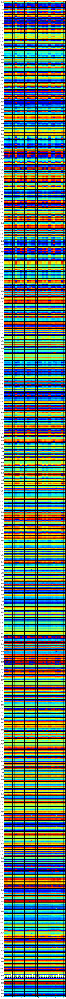

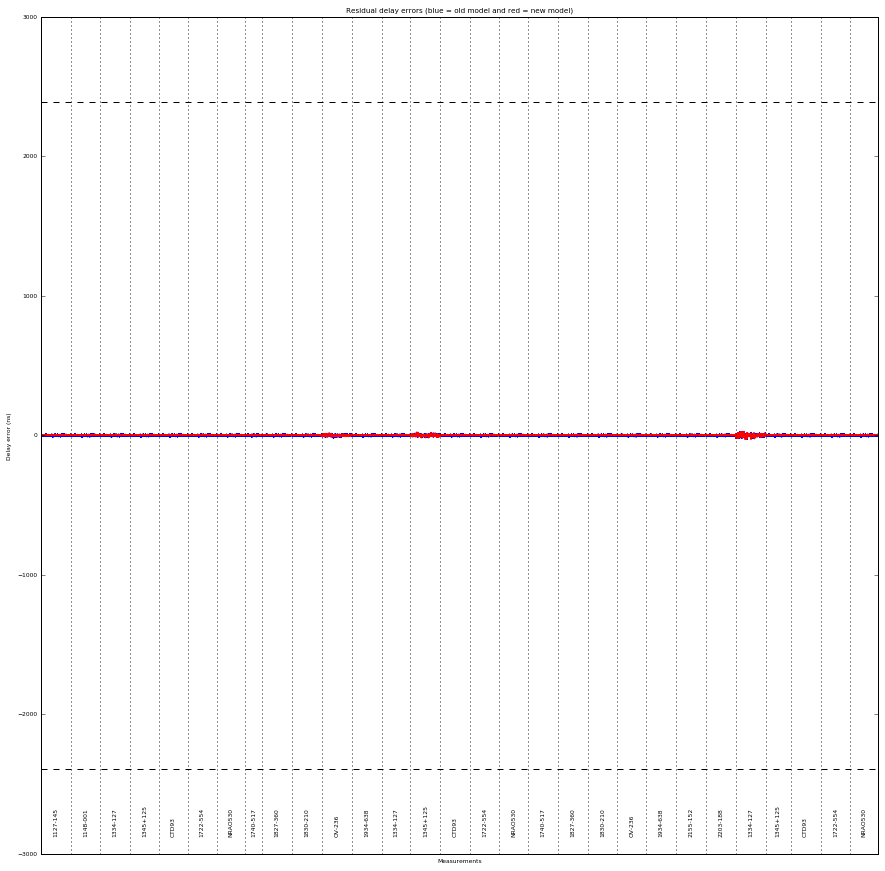

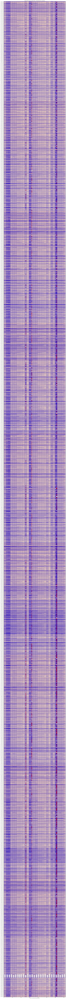

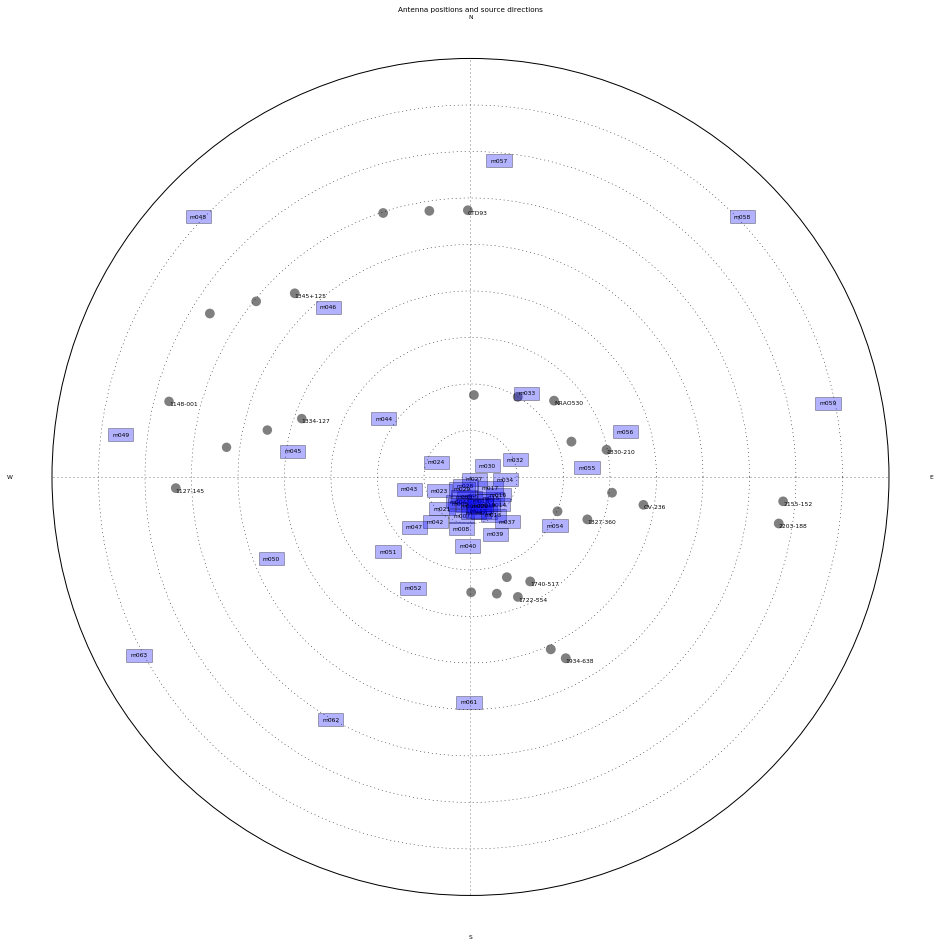

In [11]:
figure(1,figsize=(15,240))
figure(2,figsize=(15,15))
figure(3,figsize=(15,240))
figure(4,figsize=(15,15))
%run -e /var/kat/katsdpscripts/reduction/baseline_cal_reduction.py -f 2200,2914 -p 'V' -r $ref_ant \
 -a $ants -x '1709-281' $h5_filename


In [12]:
res_h = !python /var/kat/katsdpscripts/reduction/baseline_cal_reduction.py -f 2200,2914 -p 'H' -r $ref_ant \
  -a $ants -x '1709-281'  $h5_filename
print "Done H"

Done H


In [13]:
res_v = !python /var/kat/katsdpscripts/reduction/baseline_cal_reduction.py -f 2200,2914 -p 'V' -r $ref_ant \
  -a $ants -x '1709-281' $h5_filename
print "Done V"

Done V


In [14]:
delays_h = {}
for i,r in enumerate(res_h):
    if r.startswith('Antenna'):
        ant = r[8:12]
        delays_h[ant] = {}
        delays_h[ant]['E'] = float(res_h[i+2].split(':')[1].lstrip().split(' ')[0])
        delays_h[ant]['N'] = float(res_h[i+3].split(':')[1].lstrip().split(' ')[0])
        delays_h[ant]['U'] = float(res_h[i+4].split(':')[1].lstrip().split(' ')[0])
        delays_h[ant]['D'] = float(res_h[i+5].split(':')[1].lstrip().split(' ')[0])
delays_h

{'m000': {'D': 5875.413, 'E': -8.263, 'N': -207.291, 'U': 1.214},
 'm003': {'D': 5872.902, 'E': -66.518, 'N': -202.278, 'U': 0.889},
 'm004': {'D': 5873.024, 'E': -123.617, 'N': -252.945, 'U': 1.114},
 'm005': {'D': 5877.82, 'E': -102.088, 'N': -283.12, 'U': 1.475},
 'm006': {'D': 5879.813, 'E': -18.228, 'N': -295.431, 'U': 1.787},
 'm007': {'D': 5888.251, 'E': -89.588, 'N': -402.734, 'U': 2.368},
 'm008': {'D': 5874.737, 'E': -93.531, 'N': -535.032, 'U': 3.039},
 'm009': {'D': 5850.513, 'E': 32.354, 'N': -371.06, 'U': 2.736},
 'm011': {'D': 5882.337, 'E': 84.008, 'N': -352.084, 'U': 2.751},
 'm012': {'D': 5863.324, 'E': 140.012, 'N': -368.273, 'U': 3.046},
 'm013': {'D': 5863.626, 'E': 236.783, 'N': -393.467, 'U': 3.723},
 'm014': {'D': 5869.91, 'E': 280.661, 'N': -285.795, 'U': 3.144},
 'm015': {'D': 5918.716, 'E': 210.638, 'N': -219.146, 'U': 2.34},
 'm016': {'D': 5814.447, 'E': 288.148, 'N': -185.888, 'U': 2.454},
 'm017': {'D': 5874.244, 'E': 199.622, 'N': -112.266, 'U': 1.556},
 

In [15]:
delays_v = {}
for i,r in enumerate(res_v):
    if r.startswith('Antenna'):
        ant = r[8:12]
        delays_v[ant] = {}
        delays_v[ant]['E'] = float(res_v[i+2].split(':')[1].lstrip().split(' ')[0])
        delays_v[ant]['N'] = float(res_v[i+3].split(':')[1].lstrip().split(' ')[0])
        delays_v[ant]['U'] = float(res_v[i+4].split(':')[1].lstrip().split(' ')[0])
        delays_v[ant]['D'] = float(res_v[i+5].split(':')[1].lstrip().split(' ')[0])
delays_v

{'m000': {'D': 5875.693, 'E': -8.263, 'N': -207.293, 'U': 1.215},
 'm003': {'D': 5873.794, 'E': -66.517, 'N': -202.279, 'U': 0.889},
 'm004': {'D': 5874.028, 'E': -123.618, 'N': -252.946, 'U': 1.109},
 'm005': {'D': 5878.919, 'E': -102.088, 'N': -283.12, 'U': 1.475},
 'm006': {'D': 5880.975, 'E': -18.229, 'N': -295.432, 'U': 1.786},
 'm007': {'D': 5889.608, 'E': -89.589, 'N': -402.735, 'U': 2.366},
 'm008': {'D': 5876.001, 'E': -93.533, 'N': -535.033, 'U': 3.038},
 'm009': {'D': 5851.888, 'E': 32.353, 'N': -371.062, 'U': 2.736},
 'm011': {'D': 5882.851, 'E': 84.006, 'N': -352.086, 'U': 2.747},
 'm012': {'D': 5864.339, 'E': 140.012, 'N': -368.275, 'U': 3.044},
 'm013': {'D': 5864.495, 'E': 236.78, 'N': -393.468, 'U': 3.719},
 'm014': {'D': 5870.652, 'E': 280.66, 'N': -285.797, 'U': 3.14},
 'm015': {'D': 5919.231, 'E': 210.638, 'N': -219.147, 'U': 2.34},
 'm016': {'D': 5815.459, 'E': 288.148, 'N': -185.878, 'U': 2.395},
 'm017': {'D': 5875.609, 'E': 199.622, 'N': -112.267, 'U': 1.555},
 

# Cross check between polarizations for derived positions

In [16]:
for a in sorted(delays_v):
    print a,
    print("diff E %06.3f") %(delays_h[a]['E'] - delays_v[a]['E']),
    print("diff N %06.3f") %(delays_h[a]['N'] - delays_v[a]['N']),
    print("diff U %06.3f") %(delays_h[a]['U'] - delays_v[a]['U']),
    print("diff D %06.3f") %(delays_h[a]['D'] - delays_v[a]['D'])
    
# expect differences between E,N and U less than 1cm and Delays less than 3m 

m000 diff E 00.000 diff N 00.002 diff U -0.001 diff D -0.280
m003 diff E -0.001 diff N 00.001 diff U 00.000 diff D -0.892
m004 diff E 00.001 diff N 00.001 diff U 00.005 diff D -1.004
m005 diff E 00.000 diff N 00.000 diff U 00.000 diff D -1.099
m006 diff E 00.001 diff N 00.001 diff U 00.001 diff D -1.162
m007 diff E 00.001 diff N 00.001 diff U 00.002 diff D -1.357
m008 diff E 00.002 diff N 00.001 diff U 00.001 diff D -1.264
m009 diff E 00.001 diff N 00.002 diff U 00.000 diff D -1.375
m011 diff E 00.002 diff N 00.002 diff U 00.004 diff D -0.514
m012 diff E 00.000 diff N 00.002 diff U 00.002 diff D -1.015
m013 diff E 00.003 diff N 00.001 diff U 00.004 diff D -0.869
m014 diff E 00.001 diff N 00.002 diff U 00.004 diff D -0.742
m015 diff E 00.000 diff N 00.001 diff U 00.000 diff D -0.515
m016 diff E 00.000 diff N -0.010 diff U 00.059 diff D -1.012
m017 diff E 00.000 diff N 00.001 diff U 00.001 diff D -1.365
m018 diff E 00.000 diff N 00.000 diff U 00.001 diff D -0.766
m019 diff E 00.000 diff 

In [17]:
# write solutions to file
matchRe = re.findall('[0-9]{10,}', h5_filename)
filename='delay_file_'+''.join(matchRe)+'.txt'

with open(filename, 'w') as f:
    for h,v in zip(delays_h,delays_v):
        print >> f, h,v, mean([delays_h[h]['E'],delays_v[v]['E']]) , \
                    mean([delays_h[h]['N'],delays_v[v]['N']]), \
                    mean([delays_h[h]['U'],delays_v[v]['U']]), \
                    delays_h[h]['D'],delays_v[v]['D']
    f.close()

In [18]:
# sort delay file by antenna name and load antennaLOC
sample = open(filename, 'r')
sorter = csv.reader(sample, delimiter=' ')
sort = sorted(sorter, key=operator.itemgetter(1))

with open('ant_loc.csv', 'r') as f:
    tocs = f.read()

In [19]:
cols = ['Ants', 'Delay', 'East', 'North', 'UP', 'TOC']
df = pd.DataFrame(columns=cols)
for line in sort:
    p = re.compile(line[0]+',\s+\d{4}\.\d{1,3}')
    toc = float(p.search(tocs).group()[6:])
    df = df.append(pd.Series(
                             [
                                line[0],
                                line[-2],
                                line[2],
                                line[3],
                                line[4], 
                                toc
                             ], 
                              index=['Ants', 'Delay', 'East', 'North', 'UP', 'TOC']
                            ), ignore_index = True)

In [20]:
deltaTOC, deltaUP = [], []
deltaTOC.append(0)
deltaUP.append(0)
for i in range(1, len(df.TOC[1:])+1):
    deltaTOC.append(df.TOC[i] - df.TOC[i-1])
    deltaUP.append(float(df.UP[i]) - float(df.UP[i-1]))

em  = [' ' for i in range(len(deltaUP))]
df[' '] =  pd.Series(em,  index = df.index)

df['delta UP']  = pd.Series(deltaUP,  index = df.index)
df['delta TOC'] = pd.Series(deltaTOC, index = df.index)

print('\nDelay Solutions and antenna locations\n')
df


Delay Solutions and antenna locations



,Ants,Delay,East,North,UP,TOC,,delta UP,delta TOC
0,m000,5875.413,-8.263,-207.292,1.2145,1052.205,,0.0000,0.000
1,m003,5872.902,-66.5175,-202.2785,0.889,1051.754,,-0.3255,-0.451
2,m004,5873.024,-123.6175,-252.9455,1.1115,1051.976,,0.2225,0.222
3,m005,5877.82,-102.088,-283.12,1.475,1052.430,,0.3635,0.454
4,m006,5879.813,-18.2285,-295.4315,1.7865,1052.590,,0.3115,0.160
5,m007,5888.251,-89.5885,-402.7345,2.367,1053.092,,0.5805,0.502
6,m008,5874.737,-93.532,-535.0325,3.0385,1053.990,,0.6715,0.898
7,m009,5850.513,32.3535,-371.061,2.736,1053.549,,-0.3025,-0.441
8,m011,5882.337,84.007,-352.085,2.749,1053.521,,0.0130,-0.028
9,m012,5863.324,140.012,-368.274,3.045,1053.730,,0.2960,0.209


In [21]:
# send file to ops server to process and push to github

opsServer='ops.kat.ac.za'
rPath='/home/kat/ops_team_sw/utilities/update_delay_models'
cmd = "sshpass -p {} scp -r {} kat@{}:{}".format('kat', filename, opsServer, rPath)
system(cmd)


32512